In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

In [2]:
data = pd.read_csv('Telco-Customer-Churn_clean.csv')
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
data.head()

,Unnamed: 0,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,0,7590-VHVEG,Female,0,Yes,No,1,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
1,1,5575-GNVDE,Male,0,No,No,34,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1936.30,No
2,2,3668-QPYBK,Male,0,No,No,2,Yes,No,DSL,Yes,Yes,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,107.70,Yes
3,3,7795-CFOCW,Male,0,No,No,45,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1903.50,No
4,4,9237-HQITU,Female,0,No,No,2,Yes,No,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,141.40,Yes


In [3]:
data = data.drop(['Unnamed: 0', 'customerID'], axis =1)

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7043 entries, 0 to 7042
Data columns (total 20 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   gender            7043 non-null   object 
 1   SeniorCitizen     7043 non-null   int64  
 2   Partner           7043 non-null   object 
 3   Dependents        7043 non-null   object 
 4   tenure            7043 non-null   int64  
 5   PhoneService      7043 non-null   object 
 6   MultipleLines     7043 non-null   object 
 7   InternetService   7043 non-null   object 
 8   OnlineSecurity    7043 non-null   object 
 9   OnlineBackup      7043 non-null   object 
 10  DeviceProtection  7043 non-null   object 
 11  TechSupport       7043 non-null   object 
 12  StreamingTV       7043 non-null   object 
 13  StreamingMovies   7043 non-null   object 
 14  Contract          7043 non-null   object 
 15  PaperlessBilling  7043 non-null   object 
 16  PaymentMethod     7043 non-null   object 


In [5]:
data['SeniorCitizen'].unique()

array([0, 1], dtype=int64)

In [6]:
cat = data[['gender', 'Partner', 'Dependents','PhoneService','MultipleLines', 'InternetService', 'OnlineSecurity', 'OnlineBackup', 
     'DeviceProtection', 'TechSupport', 'StreamingTV', 'StreamingMovies', 'PaperlessBilling', 'PaymentMethod', 'Contract']].astype('category')

In [7]:
cat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7043 entries, 0 to 7042
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   gender            7043 non-null   category
 1   Partner           7043 non-null   category
 2   Dependents        7043 non-null   category
 3   PhoneService      7043 non-null   category
 4   MultipleLines     7043 non-null   category
 5   InternetService   7043 non-null   category
 6   OnlineSecurity    7043 non-null   category
 7   OnlineBackup      7043 non-null   category
 8   DeviceProtection  7043 non-null   category
 9   TechSupport       7043 non-null   category
 10  StreamingTV       7043 non-null   category
 11  StreamingMovies   7043 non-null   category
 12  PaperlessBilling  7043 non-null   category
 13  PaymentMethod     7043 non-null   category
 14  Contract          7043 non-null   category
dtypes: category(15)
memory usage: 105.3 KB


In [8]:
cat = pd.get_dummies(cat, drop_first = True)
cat

,gender_Male,Partner_Yes,Dependents_Yes,PhoneService_Yes,MultipleLines_No phone service,MultipleLines_Yes,InternetService_Fiber optic,InternetService_No,OnlineSecurity_No internet service,OnlineSecurity_Yes,OnlineBackup_No internet service,OnlineBackup_Yes,DeviceProtection_No internet service,DeviceProtection_Yes,TechSupport_No internet service,TechSupport_Yes,StreamingTV_No internet service,StreamingTV_Yes,StreamingMovies_No internet service,StreamingMovies_Yes,PaperlessBilling_Yes,PaymentMethod_Credit card (automatic),PaymentMethod_Electronic check,PaymentMethod_Mailed check,Contract_One year,Contract_Two year
0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0
1,1,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,1,0
2,1,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0
3,1,0,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0
4,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0
5,0,0,0,1,0,1,1,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,1,0,0,0
6,1,0,1,1,0,1,1,0,0,0,0,1,0,0,0,0,0,1,0,0,1,1,0,0,0,0
7,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
8,0,1,0,1,0,1,1,0,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,0,0
9,1,0,1,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0


In [9]:
cat = cat.join(data['SeniorCitizen'])

In [10]:
cat = cat.join(data['tenure'])

In [11]:
cat = cat.join(data['MonthlyCharges'])

In [12]:
cat = cat.join(data['TotalCharges'])

In [13]:
cat = cat.join(data['Churn'])
cat

,gender_Male,Partner_Yes,Dependents_Yes,PhoneService_Yes,MultipleLines_No phone service,MultipleLines_Yes,InternetService_Fiber optic,InternetService_No,OnlineSecurity_No internet service,OnlineSecurity_Yes,OnlineBackup_No internet service,OnlineBackup_Yes,DeviceProtection_No internet service,DeviceProtection_Yes,TechSupport_No internet service,TechSupport_Yes,StreamingTV_No internet service,StreamingTV_Yes,StreamingMovies_No internet service,StreamingMovies_Yes,PaperlessBilling_Yes,PaymentMethod_Credit card (automatic),PaymentMethod_Electronic check,PaymentMethod_Mailed check,Contract_One year,Contract_Two year,SeniorCitizen,tenure,MonthlyCharges,TotalCharges,Churn
0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,1,29.85,29.85,No
1,1,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,1,1,0,0,34,56.95,1936.30,No
2,1,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,2,53.85,107.70,Yes
3,1,0,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,45,42.30,1903.50,No
4,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,2,70.70,141.40,Yes
5,0,0,0,1,0,1,1,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,1,0,0,0,0,8,99.65,797.20,Yes
6,1,0,1,1,0,1,1,0,0,0,0,1,0,0,0,0,0,1,0,0,1,1,0,0,0,0,0,22,89.10,1960.20,No
7,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,10,29.75,297.50,No
8,0,1,0,1,0,1,1,0,0,0,0,0,0,1,0,1,0,1,0,1,1,0,1,0,0,0,0,28,104.80,2934.40,Yes
9,1,0,1,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,62,56.15,3481.30,No


In [14]:
X = cat.iloc[:, :-1].values
Y = cat.iloc[:, -1].values
X,Y

(array([[0.0000e+00, 1.0000e+00, 0.0000e+00, ..., 1.0000e+00, 2.9850e+01,
         2.9850e+01],
        [1.0000e+00, 0.0000e+00, 0.0000e+00, ..., 3.4000e+01, 5.6950e+01,
         1.9363e+03],
        [1.0000e+00, 0.0000e+00, 0.0000e+00, ..., 2.0000e+00, 5.3850e+01,
         1.0770e+02],
        ...,
        [0.0000e+00, 1.0000e+00, 1.0000e+00, ..., 1.1000e+01, 2.9600e+01,
         3.2560e+02],
        [1.0000e+00, 1.0000e+00, 0.0000e+00, ..., 4.0000e+00, 7.4400e+01,
         2.9760e+02],
        [1.0000e+00, 0.0000e+00, 0.0000e+00, ..., 6.6000e+01, 1.0565e+02,
         6.9729e+03]]),
 array(['No', 'No', 'Yes', ..., 'No', 'Yes', 'No'], dtype=object))

In [15]:
# Encoding the Dependent Variable
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
Y = le.fit_transform(Y)
print(Y)

[0 0 1 ... 0 1 0]


<AxesSubplot:ylabel='count'>

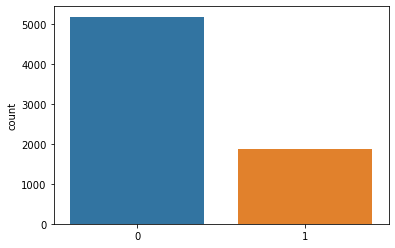

In [103]:
# Checking whether data is imbalanced
sns.countplot(x= Y)

In [16]:
# Splitting the dataset into the Training set and Test set
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size = 0.25, random_state = 0)

#### Model Creation: ####

##### Random Forest Classifier ####

In [17]:
# Feature Scaling
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)


# Training the Random Forest Classification model on the Training set
from sklearn.ensemble import RandomForestClassifier
classifier = RandomForestClassifier(n_estimators = 10, criterion = 'entropy', random_state = 0)
classifier.fit(X_train, y_train)

# Predicting the Test set results
y_pred = classifier.predict(X_test)

In [108]:
# Making the Confusion Matrix
from sklearn.metrics import confusion_matrix, accuracy_score, roc_auc_score, f1_score
cm = confusion_matrix(y_test, y_pred)
ac = accuracy_score(y_test, y_pred)
roc_auc = roc_auc_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)
print(cm, ac, roc_auc, f1)

[[1175  123]
 [ 254  209]] 0.7859170925610448 0.6783213583283138 0.5257861635220126


In [19]:
# Hyperparameter Tuning using RandomizedSearchCV
from sklearn.model_selection import RandomizedSearchCV

In [20]:
#RandomSearchCV


# no. of trees
n_estimators = [int(x) for x in np.linspace(start = 100, stop = 1200, num = 12)]
# no. of features at every split
max_features = ['auto','sqrt']
# max. no. of levels
max_depth = [int(x) for x in np.linspace(start = 5, stop = 30, num = 6)]
# min no. of nodes required to split a node
min_samples_split = [2,5,10,15,100]
# min no. of samples required at each node
min_samples_leaf = [1,2,5,10]

In [21]:
random_grid = {'n_estimators': n_estimators,
              'max_features': max_features,
              'max_depth': max_depth,
              'min_samples_split': min_samples_split,
              'min_samples_leaf': min_samples_leaf}

In [22]:
rf_random = RandomizedSearchCV(estimator = classifier, param_distributions = random_grid, cv = 5, scoring = 'roc_auc', 
                               n_iter = 10, verbose = 2, random_state = 42, n_jobs = 1 )

In [23]:
rf_random.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END max_depth=10, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, n_estimators=900; total time=   5.2s
[CV] END max_depth=10, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, n_estimators=900; total time=   4.7s
[CV] END max_depth=10, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, n_estimators=900; total time=   5.4s
[CV] END max_depth=10, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, n_estimators=900; total time=   5.9s
[CV] END max_depth=10, max_features=sqrt, min_samples_leaf=5, min_samples_split=5, n_estimators=900; total time=   5.9s
[CV] END max_depth=15, max_features=sqrt, min_samples_leaf=2, min_samples_split=10, n_estimators=1100; total time=   6.6s
[CV] END max_depth=15, max_features=sqrt, min_samples_leaf=2, min_samples_split=10, n_estimators=1100; total time=   7.3s
[CV] END max_depth=15, max_features=sqrt, min_samples_leaf=2, min_samples_split=10, n_estimator

RandomizedSearchCV(cv=5,
                   estimator=RandomForestClassifier(criterion='entropy',
                                                    n_estimators=10,
                                                    random_state=0),
                   n_jobs=1,
                   param_distributions={'max_depth': [5, 10, 15, 20, 25, 30],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 2, 5, 10],
                                        'min_samples_split': [2, 5, 10, 15,
                                                              100],
                                        'n_estimators': [100, 200, 300, 400,
                                                         500, 600, 700, 800,
                                                         900, 1000, 1100,
                                                         1200]},
                   random_state=42, scoring='roc_auc', verbose=2)

In [24]:
rf_random.best_params_

{'n_estimators': 300,
 'min_samples_split': 100,
 'min_samples_leaf': 5,
 'max_features': 'auto',
 'max_depth': 15}

In [25]:
predict = rf_random.predict(X_test)

In [109]:
# Making the Confusion Matrix
from sklearn.metrics import confusion_matrix, accuracy_score, roc_auc_score, f1_score
cm = confusion_matrix(y_test, predict)
rf_ac = accuracy_score(y_test, predict)
rf_roc_auc = roc_auc_score(y_test, predict)
rf_f1 = f1_score(y_test, predict)
print(cm, rf_ac, rf_roc_auc, rf_f1)

[[1181  117]
 [ 249  214]] 0.7921635434412265 0.6860321744368308 0.5390428211586902


##### Decission Tree Classifier ####

In [27]:
from sklearn.tree import DecisionTreeClassifier
DTclf = DecisionTreeClassifier(random_state=0)
DTclf.fit(X_train, y_train)

# Predicting the Test set results
y_predict = DTclf.predict(X_test)

In [28]:
# Making the Confusion Matrix
from sklearn.metrics import confusion_matrix, accuracy_score, roc_auc_score
cm = confusion_matrix(y_test, y_predict)
ac = accuracy_score(y_test, y_predict)
roc_auc = roc_auc_score(y_test, y_predict)
print(cm, ac, roc_auc)

[[1052  246]
 [ 225  238]] 0.7325383304940375 0.662258267412567


In [29]:
#RandomSearchCV


criterion = ['gini', 'entropy']
# no. of features at every split
max_features = ['auto','sqrt']
# max. no. of levels
max_depth = [int(x) for x in np.linspace(start = 5, stop = 30, num = 6)]
# min no. of nodes required to split a node
min_samples_split = [2,5,10,15,100]
# min no. of samples required at each node
min_samples_leaf = [1,2,5,10]

In [30]:
random_grid = {'criterion': criterion,
              'max_features': max_features,
              'max_depth': max_depth,
              'min_samples_split': min_samples_split,
              'min_samples_leaf': min_samples_leaf}

In [31]:
DT = RandomizedSearchCV(estimator = DTclf, param_distributions = random_grid, cv = 5, scoring = 'roc_auc', 
                               n_iter = 10, verbose = 2, random_state = 42, n_jobs = 1 )

In [32]:
DT.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=5, min_samples_split=15; total time=   0.0s
[CV] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=5, min_samples_split=15; total time=   0.0s
[CV] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=5, min_samples_split=15; total time=   0.0s
[CV] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=5, min_samples_split=15; total time=   0.0s
[CV] END criterion=gini, max_depth=10, max_features=sqrt, min_samples_leaf=5, min_samples_split=15; total time=   0.0s
[CV] END criterion=entropy, max_depth=25, max_features=auto, min_samples_leaf=5, min_samples_split=100; total time=   0.0s
[CV] END criterion=entropy, max_depth=25, max_features=auto, min_samples_leaf=5, min_samples_split=100; total time=   0.0s
[CV] END criterion=entropy, max_depth=25, max_features=auto, min_samples_leaf=5, min_samples_split

RandomizedSearchCV(cv=5, estimator=DecisionTreeClassifier(random_state=0),
                   n_jobs=1,
                   param_distributions={'criterion': ['gini', 'entropy'],
                                        'max_depth': [5, 10, 15, 20, 25, 30],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 2, 5, 10],
                                        'min_samples_split': [2, 5, 10, 15,
                                                              100]},
                   random_state=42, scoring='roc_auc', verbose=2)

In [33]:
DT.best_params_

{'min_samples_split': 15,
 'min_samples_leaf': 2,
 'max_features': 'sqrt',
 'max_depth': 5,
 'criterion': 'entropy'}

In [34]:
prediction = DT.predict(X_test)

In [110]:

from sklearn.metrics import confusion_matrix, accuracy_score, roc_auc_score, f1_score
cm = confusion_matrix(y_test, prediction)
DT_ac = accuracy_score(y_test, prediction)
DT_roc_auc = roc_auc_score(y_test, prediction)
DT_f1 = f1_score(y_test, prediction)
print(cm, DT_ac, DT_roc_auc, DT_f1)

[[1155  143]
 [ 229  234]] 0.7887563884156729 0.6976150382545667 0.5571428571428572


##### SVM

In [36]:
from sklearn.svm import SVC
SVclassifier = SVC(kernel = 'rbf', random_state = 0)
SVclassifier.fit(X_train, y_train)


# Predicting the Test set results
svc_pred = SVclassifier.predict(X_test)

In [37]:
from sklearn.metrics import confusion_matrix, accuracy_score, roc_auc_score
cm = confusion_matrix(y_test, svc_pred)
ac = accuracy_score(y_test, svc_pred)
roc_auc = roc_auc_score(y_test, svc_pred)
print(cm, ac, roc_auc)

[[1171  127]
 [ 250  213]] 0.7859170925610448 0.6811001807066529


In [38]:
#RandomSearchCV

C = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]
kernel = ['linear', 'poly', 'rbf', 'sigmoid']
gamma = ['auto','scale']
decision_function_shape = ['ovo','ovr']

In [39]:
random_grid = {'C': C,
              'kernel': kernel,
              'gamma': gamma,
              'decision_function_shape': decision_function_shape}

In [40]:
SVClass = RandomizedSearchCV(estimator = SVclassifier, param_distributions = random_grid, cv = 5, scoring = 'roc_auc', 
                               n_iter = 10, verbose = 2, random_state = 42, n_jobs = 1 )

In [41]:
SVClass.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END C=0.7, decision_function_shape=ovr, gamma=auto, kernel=poly; total time=   0.8s
[CV] END C=0.7, decision_function_shape=ovr, gamma=auto, kernel=poly; total time=   0.8s
[CV] END C=0.7, decision_function_shape=ovr, gamma=auto, kernel=poly; total time=   0.8s
[CV] END C=0.7, decision_function_shape=ovr, gamma=auto, kernel=poly; total time=   0.8s
[CV] END C=0.7, decision_function_shape=ovr, gamma=auto, kernel=poly; total time=   0.8s
[CV] END C=0.7, decision_function_shape=ovr, gamma=scale, kernel=linear; total time=   1.1s
[CV] END C=0.7, decision_function_shape=ovr, gamma=scale, kernel=linear; total time=   1.0s
[CV] END C=0.7, decision_function_shape=ovr, gamma=scale, kernel=linear; total time=   1.0s
[CV] END C=0.7, decision_function_shape=ovr, gamma=scale, kernel=linear; total time=   1.0s
[CV] END C=0.7, decision_function_shape=ovr, gamma=scale, kernel=linear; total time=   1.1s
[CV] END C=0.9, decision_function_

RandomizedSearchCV(cv=5, estimator=SVC(random_state=0), n_jobs=1,
                   param_distributions={'C': [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7,
                                              0.8, 0.9, 1.0],
                                        'decision_function_shape': ['ovo',
                                                                    'ovr'],
                                        'gamma': ['auto', 'scale'],
                                        'kernel': ['linear', 'poly', 'rbf',
                                                   'sigmoid']},
                   random_state=42, scoring='roc_auc', verbose=2)

In [42]:
SVClass.best_params_

{'kernel': 'linear',
 'gamma': 'scale',
 'decision_function_shape': 'ovr',
 'C': 0.7}

In [43]:
SVCprediction = SVClass.predict(X_test)

In [111]:
from sklearn.metrics import confusion_matrix, accuracy_score, roc_auc_score, f1_score
cm = confusion_matrix(y_test, SVCprediction)
SVC_ac = accuracy_score(y_test, SVCprediction)
SVC_roc_auc = roc_auc_score(y_test, SVCprediction)
SVC_f1 = f1_score(y_test, SVCprediction)
print(cm, SVC_ac, SVC_roc_auc, SVC_f1)

[[1160  138]
 [ 222  241]] 0.7955706984667802 0.7071004735645802 0.5724465558194773



##### XGBoost Classifier

In [45]:
from sklearn.model_selection import RandomizedSearchCV
import xgboost

In [46]:
params={
 "learning_rate"    : [0.05, 0.10, 0.15, 0.20, 0.25, 0.30 ] ,
 "max_depth"        : [ 3, 4, 5, 6, 8, 10, 12, 15],
 "min_child_weight" : [ 1, 3, 5, 7 ],
 "gamma"            : [ 0.0, 0.1, 0.2 , 0.3, 0.4 ],
 "colsample_bytree" : [ 0.3, 0.4, 0.5 , 0.7 ]
    
}

In [47]:
XGBclassifier=xgboost.XGBClassifier()

In [48]:
random_search=RandomizedSearchCV(XGBclassifier,param_distributions=params,n_iter=5,scoring='roc_auc',n_jobs=-1,cv=5,verbose=2)

In [49]:
random_search.fit(X_train, y_train)

Fitting 5 folds for each of 5 candidates, totalling 25 fits


C:\Users\Sarthak\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[01:12:23] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


RandomizedSearchCV(cv=5,
                   estimator=XGBClassifier(base_score=None, booster=None,
                                           colsample_bylevel=None,
                                           colsample_bynode=None,
                                           colsample_bytree=None, gamma=None,
                                           gpu_id=None, importance_type='gain',
                                           interaction_constraints=None,
                                           learning_rate=None,
                                           max_delta_step=None, max_depth=None,
                                           min_child_weight=None, missing=nan,
                                           monotone_constraints=None,
                                           n_estimators=100,...
                                           reg_lambda=None,
                                           scale_pos_weight=None,
                                           subsample=No

In [50]:
random_search.best_params_

{'min_child_weight': 1,
 'max_depth': 6,
 'learning_rate': 0.05,
 'gamma': 0.4,
 'colsample_bytree': 0.3}

In [51]:
XGpred = random_search.predict(X_test)

In [115]:
from sklearn.metrics import confusion_matrix, accuracy_score, roc_auc_score, f1_score
cm = confusion_matrix(y_test, XGpred)
XGB_ac = accuracy_score(y_test, XGpred)
XGB_roc_auc = roc_auc_score(y_test, XGpred)
XGB_f1 = f1_score(y_test, XGpred)
print(cm, XGB_ac, XGB_roc_auc, XGB_f1_score)

[[1166  132]
 [ 237  226]] 0.7904599659284497 0.6932130175348684 0.5505481120584653


##### ANN: #####

In [53]:
import tensorflow as tf

# Initializing the ANN
ann = tf.keras.models.Sequential()

# Adding the input layer and the first hidden layer
ann.add(tf.keras.layers.Dense(units=6, activation='relu'))
ann.add(tf.keras.layers.Dense(units=6, activation='relu'))
ann.add(tf.keras.layers.Dense(units=6, activation='relu'))
# Adding the output layer
ann.add(tf.keras.layers.Dense(units=1, activation='sigmoid'))

# Compiling the ANN
ann.compile(optimizer = 'adam', loss = 'binary_crossentropy', metrics = ['accuracy'])

# Training the ANN on the Training set
ann.fit(X_train, y_train, batch_size = 32, epochs = 100)

Epoch 1/100
166/166 [==============================] - 0s 1ms/step - loss: 0.5350 - accuracy: 0.7338
Epoch 2/100
166/166 [==============================] - 0s 986us/step - loss: 0.4800 - accuracy: 0.7338
Epoch 3/100
166/166 [==============================] - 0s 1ms/step - loss: 0.4560 - accuracy: 0.7461
Epoch 4/100
166/166 [==============================] - 0s 971us/step - loss: 0.4448 - accuracy: 0.7836
Epoch 5/100
166/166 [==============================] - 0s 1ms/step - loss: 0.4383 - accuracy: 0.7936
Epoch 6/100
166/166 [==============================] - 0s 995us/step - loss: 0.4342 - accuracy: 0.7933
Epoch 7/100
166/166 [==============================] - 0s 983us/step - loss: 0.4297 - accuracy: 0.8003
Epoch 8/100
166/166 [==============================] - 0s 1ms/step - loss: 0.4271 - accuracy: 0.8041
Epoch 9/100
166/166 [==============================] - 0s 1ms/step - loss: 0.4241 - accuracy: 0.8029
Epoch 10/100
166/166 [==============================] - 0s 1ms/step - loss: 0.4215 

166/166 [==============================] - 0s 1ms/step - loss: 0.3877 - accuracy: 0.8126
Epoch 81/100
166/166 [==============================] - 0s 992us/step - loss: 0.3876 - accuracy: 0.8158
Epoch 82/100
166/166 [==============================] - 0s 1ms/step - loss: 0.3870 - accuracy: 0.8162
Epoch 83/100
166/166 [==============================] - 0s 1ms/step - loss: 0.3874 - accuracy: 0.8158
Epoch 84/100
166/166 [==============================] - 0s 989us/step - loss: 0.3870 - accuracy: 0.8171
Epoch 85/100
166/166 [==============================] - 0s 975us/step - loss: 0.3873 - accuracy: 0.8150
Epoch 86/100
166/166 [==============================] - 0s 1ms/step - loss: 0.3869 - accuracy: 0.8192
Epoch 87/100
166/166 [==============================] - 0s 1ms/step - loss: 0.3863 - accuracy: 0.8183
Epoch 88/100
166/166 [==============================] - 0s 1ms/step - loss: 0.3865 - accuracy: 0.8154
Epoch 89/100
166/166 [==============================] - 0s 1ms/step - loss: 0.3862 - accu

In [54]:
ann_pred = ann.predict(X_test)
ann_pred = (ann_pred > 0.5)

In [113]:
from sklearn.metrics import confusion_matrix, accuracy_score, roc_auc_score, f1_score
cm = confusion_matrix(y_test, ann_pred)
ann_ac = accuracy_score(y_test, ann_pred)
ann_roc_auc = roc_auc_score(y_test, ann_pred)
ann_f1_score = f1_score(y_test, ann_pred)
print(cm, ann_ac, ann_roc_auc, ann_f1_score)

[[1134  164]
 [ 208  255]] 0.7887563884156729 0.7122038557408474 0.5782312925170069


#### Finding out the best model

In [117]:
Accuracy = [rf_ac, DT_ac, SVC_ac, XGB_ac, ann_ac]
ROC_AUC = [rf_roc_auc, DT_roc_auc, SVC_roc_auc, XGB_roc_auc, ann_roc_auc]
f1_score = [rf_f1, DT_f1, SVC_f1, XGB_f1, ann_f1_score]
Model = ['Random Forest', 'Decission Tree', 'SVM', 'XGBoost', 'ANN']

Text(0.5, 1.0, 'Model accuracies')

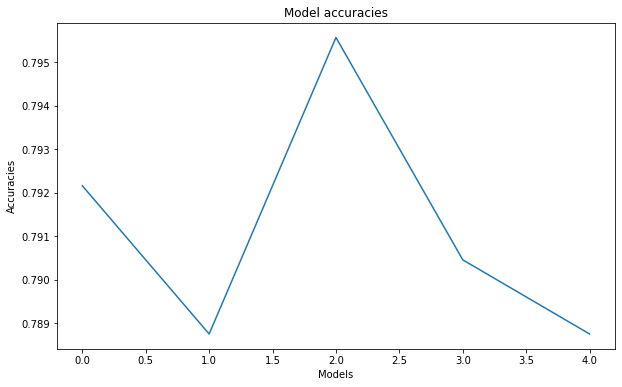

In [97]:
#Visualising accuracies
plt.figure(figsize=(10, 6))
plt.plot(Accuracy)
plt.xlabel('Models')
plt.ylabel('Accuracies')
plt.title('Model accuracies')

According the above plot it is evident that SVM classifier has the highest accuracy which is 0.7955

Text(0.5, 1.0, 'Model ROC_AUC')

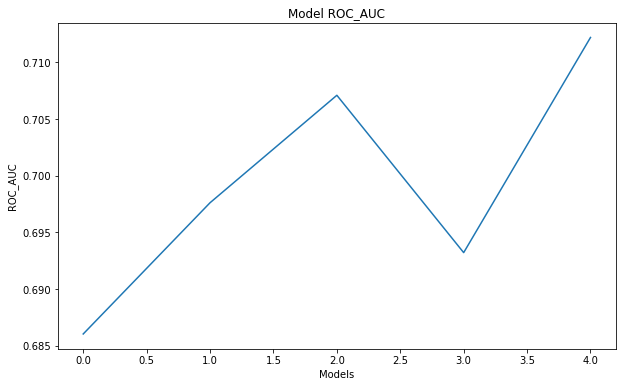

In [96]:
#Visualising accuracies
plt.figure(figsize=(10, 6))
plt.plot(ROC_AUC)
plt.xlabel('Models')
plt.ylabel('ROC_AUC')
plt.title('Model ROC_AUC')

The above plot, shows the ANN model has the highest 'ROC_AUC' score of 0.7122.

Text(0.5, 1.0, 'Model f1_score')

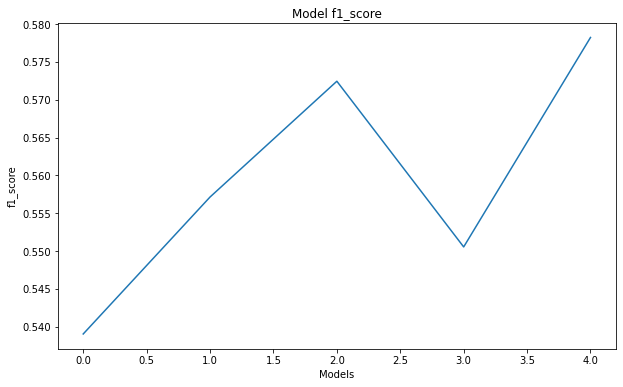

In [118]:
#Visualising accuracies
plt.figure(figsize=(10, 6))
plt.plot(f1_score)
plt.xlabel('Models')
plt.ylabel('f1_score')
plt.title('Model f1_score')

In [119]:
f1_score

[0.5390428211586902,
 0.5571428571428572,
 0.5724465558194773,
 0.5505481120584653,
 0.5782312925170069]

The above plot, shows the ANN model has the highest 'f1_score' score of 0.5782.



#### Saving the models

In [124]:

ann.save('D:/Machine Learning/Telecom customer chum/ANN/')

INFO:tensorflow:Assets written to: D:/Machine Learning/Telecom customer chum/ANN/assets


In [128]:
import pickle
# Save the Modle to file in the current working directory

Pkl_Filename = "xgboost_model.pkl"  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(random_search, file)

In [129]:
Pkl_Filename = "SVM_model.pkl"  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(SVClass, file)

In [130]:
Pkl_Filename = "DT_model.pkl"  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(DT, file)

In [131]:
Pkl_Filename = "randomForest_model.pkl"  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(rf_random, file)